<a href="https://colab.research.google.com/github/zakee14910/projectgis/blob/main/03_Data_Exploration.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install rasterio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 35.9 MB/s eta 0:00:00


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# Define the base directory for your project
import os
import sys
base_dir = '/content/drive/MyDrive/coconut_plantation_research'

# Add the code directory to the Python path
sys.path.append(f"{base_dir}/code")

# Import Earth Engine and initialize
import ee
try:
  ee.Initialize()
  print('Earth Engine already initialized')
except:
  ee.Authenticate()
  ee.Initialize(project='researchmsc')
  print('Earth Engine initialized')

# Import custom modules
from study_areas import get_study_area_geometry, study_areas

import geemap
import matplotlib.pyplot as plt
import numpy as np
import rasterio
from rasterio.plot import show


Mounted at /content/drive
Earth Engine initialized


Load and visualize downloaded images:

In [ ]:
# Function to visualize a downloaded GeoTIFF image
def visualize_geotiff(image_path, rgb_bands=(2, 1, 0), figsize=(12, 10)):
    """
    Visualize a downloaded satellite image.

    Args:
        image_path: Path to the GeoTIFF image
        rgb_bands: Tuple of band indices for RGB visualization
        figsize: Figure size for the plot
    """
    with rasterio.open(image_path) as src:
        # Read the data
        data = src.read()

        # Create RGB composite
        rgb = np.zeros((data.shape[1], data.shape[2], 3))
        for i, band in enumerate(rgb_bands):
            if band < data.shape[0]:  # Check if band exists
                rgb[:, :, i] = data[band]

        # Scale to 0-1 range for visualization
        rgb_min = np.min(rgb)
        rgb_max = np.max(rgb)
        if rgb_max > rgb_min:  # Avoid division by zero
            rgb_scaled = (rgb - rgb_min) / (rgb_max - rgb_min)
        else:
            rgb_scaled = rgb

        # Plot
        plt.figure(figsize=figsize)
        plt.imshow(rgb_scaled)
        plt.title(f"RGB Composite - {os.path.basename(image_path)}")
        plt.axis('off')

        # Save visualization
        viz_path = image_path.replace('.tif', '_rgb.png')
        plt.savefig(viz_path, dpi=300, bbox_inches='tight')
        plt.show()

        print(f"Visualization saved: {viz_path}")

# Function to visualize NDVI from a downloaded GeoTIFF image
def visualize_ndvi_geotiff(image_path, ndvi_band=-1, figsize=(12, 10)):
    """
    Visualize NDVI from a downloaded satellite image.

    Args:
        image_path: Path to the GeoTIFF image with NDVI band
        ndvi_band: Index of the NDVI band (default: last band)
        figsize: Figure size for the plot
    """
    with rasterio.open(image_path) as src:
        # Read the data
        data = src.read()

        # Get NDVI band
        if ndvi_band < 0:
            ndvi_band = data.shape[0] + ndvi_band

        if ndvi_band < data.shape[0]:  # Check if band exists
            ndvi = data[ndvi_band]

            # Plot
            plt.figure(figsize=figsize)
            plt.imshow(ndvi, cmap='RdYlGn', vmin=-0.2, vmax=0.8)
            plt.colorbar(label='NDVI')
            plt.title(f"NDVI - {os.path.basename(image_path)}")
            plt.axis('off')

            # Save visualization
            viz_path = image_path.replace('.tif', '_ndvi.png')
            plt.savefig(viz_path, dpi=300, bbox_inches='tight')
            plt.show()

            print(f"NDVI visualization saved: {viz_path}")
        else:
            print(f"NDVI band not found in {image_path}")


Explore downloaded images for a study area:

Found 19 Landsat files
Visualizing landsat_2006.tif...


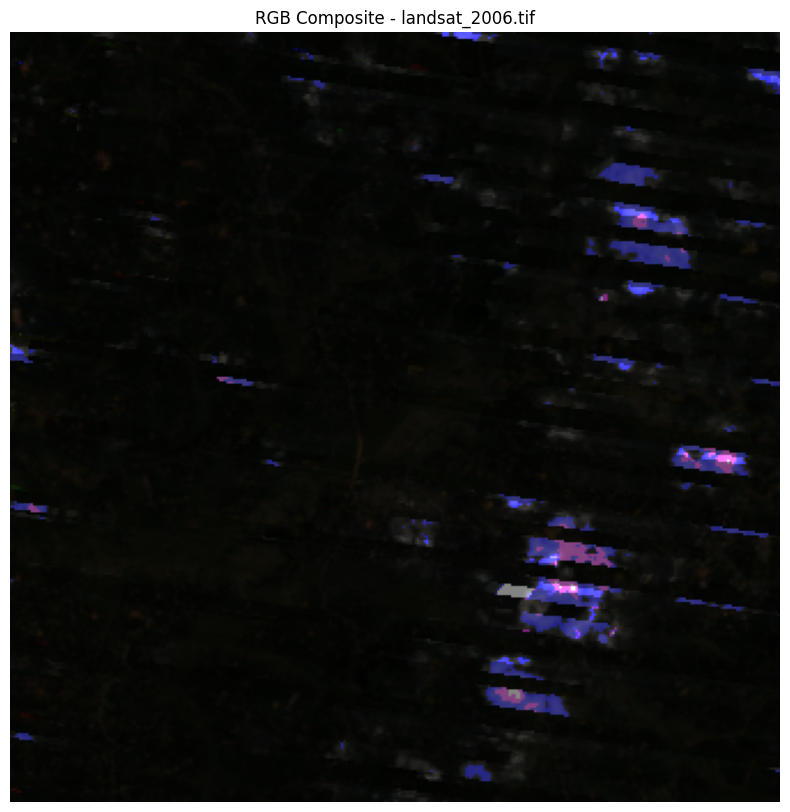

Visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2006_rgb.png


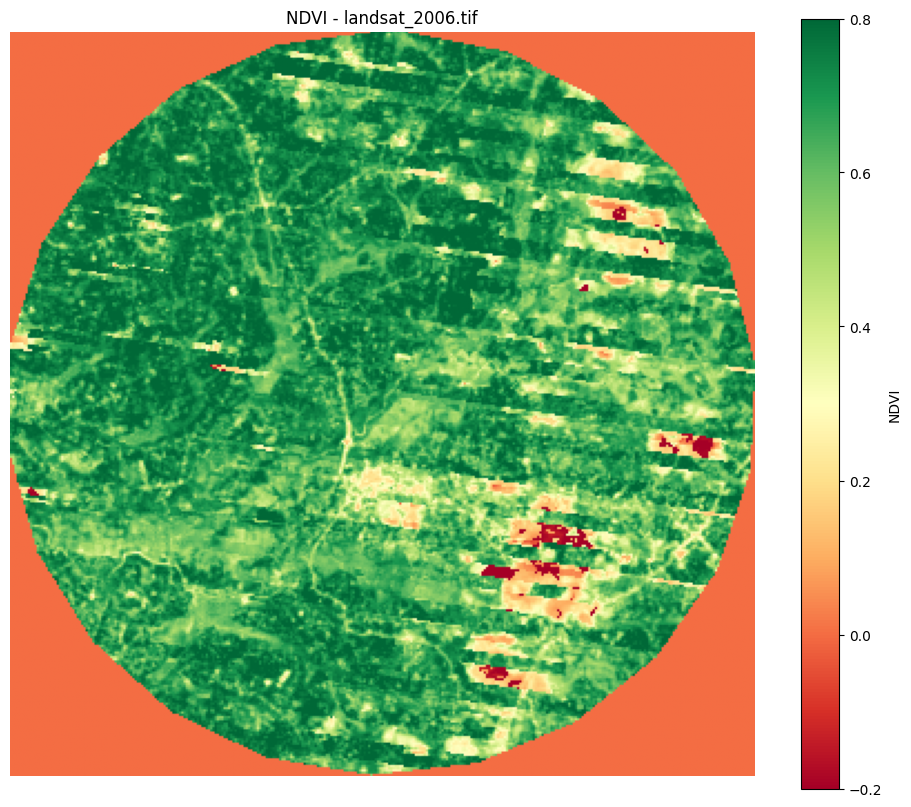

NDVI visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2006_ndvi.png
Visualizing landsat_2007.tif...


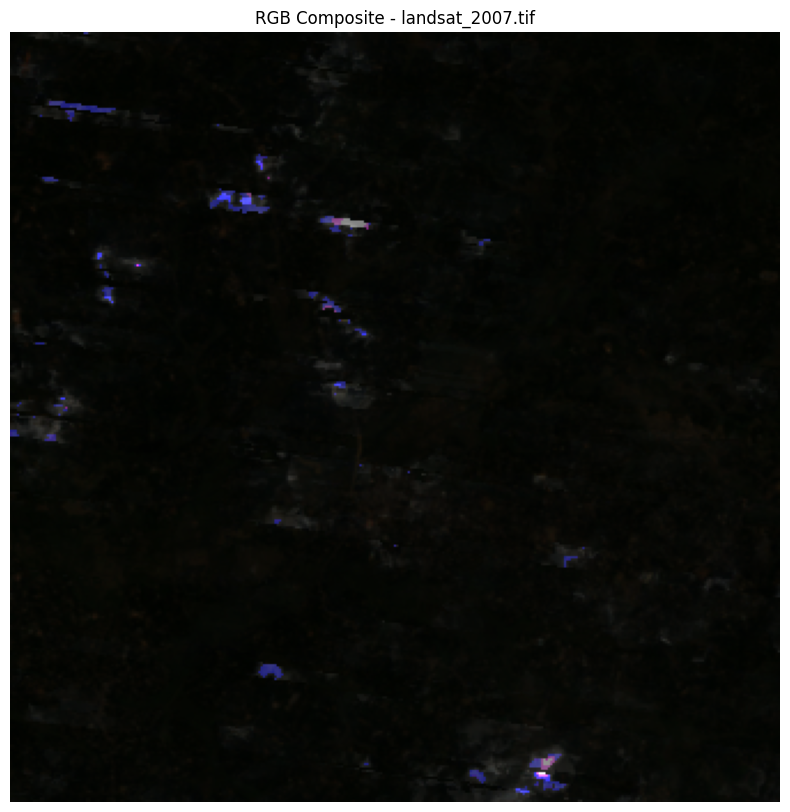

Visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2007_rgb.png


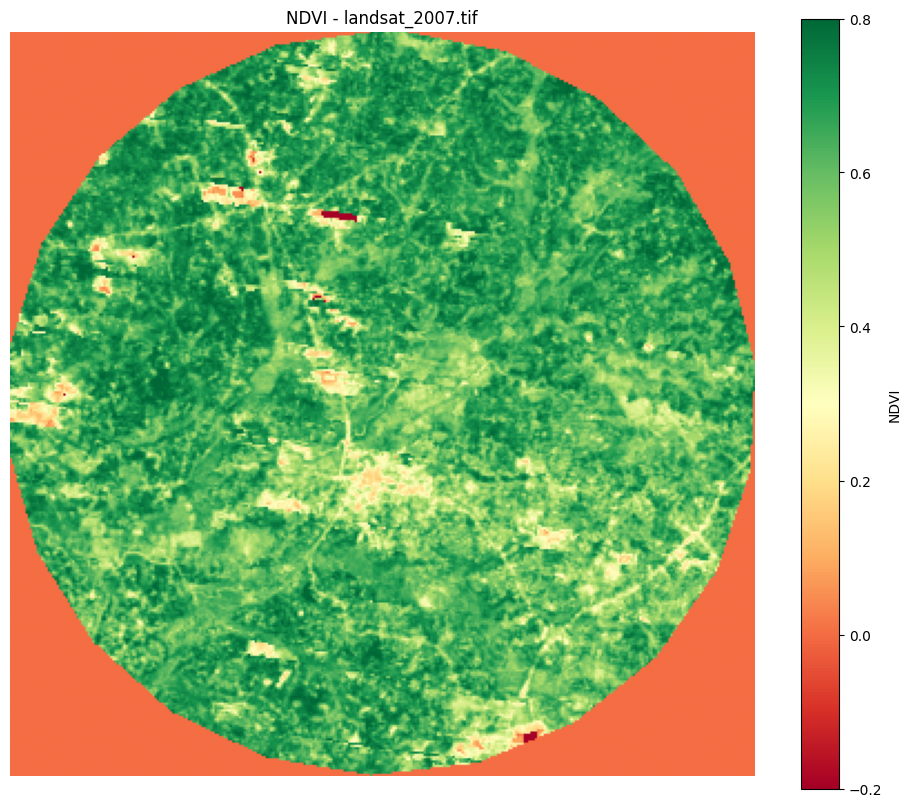

NDVI visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2007_ndvi.png
Visualizing landsat_2008.tif...


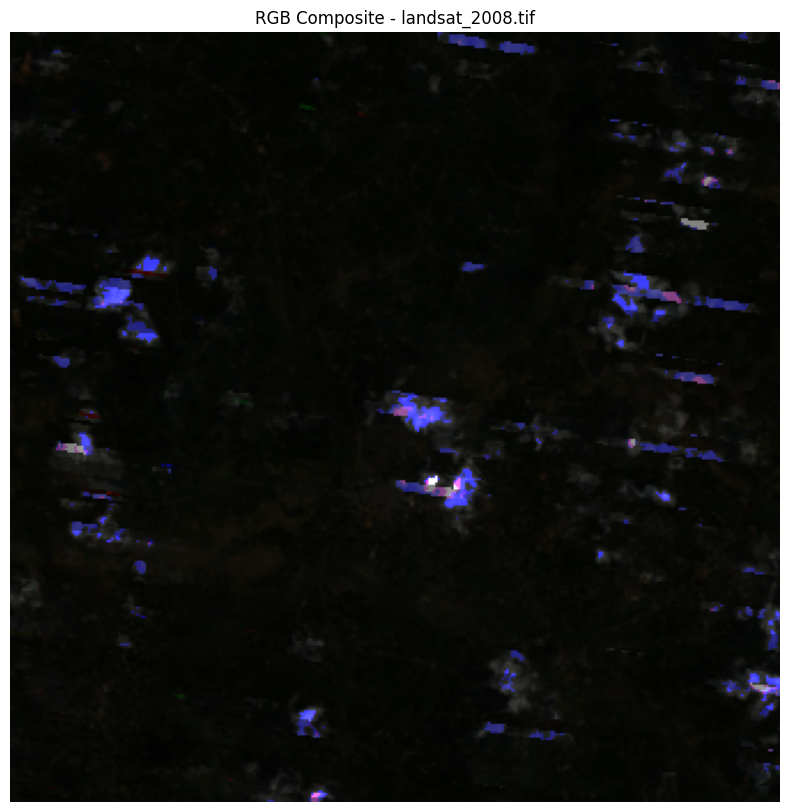

Visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2008_rgb.png


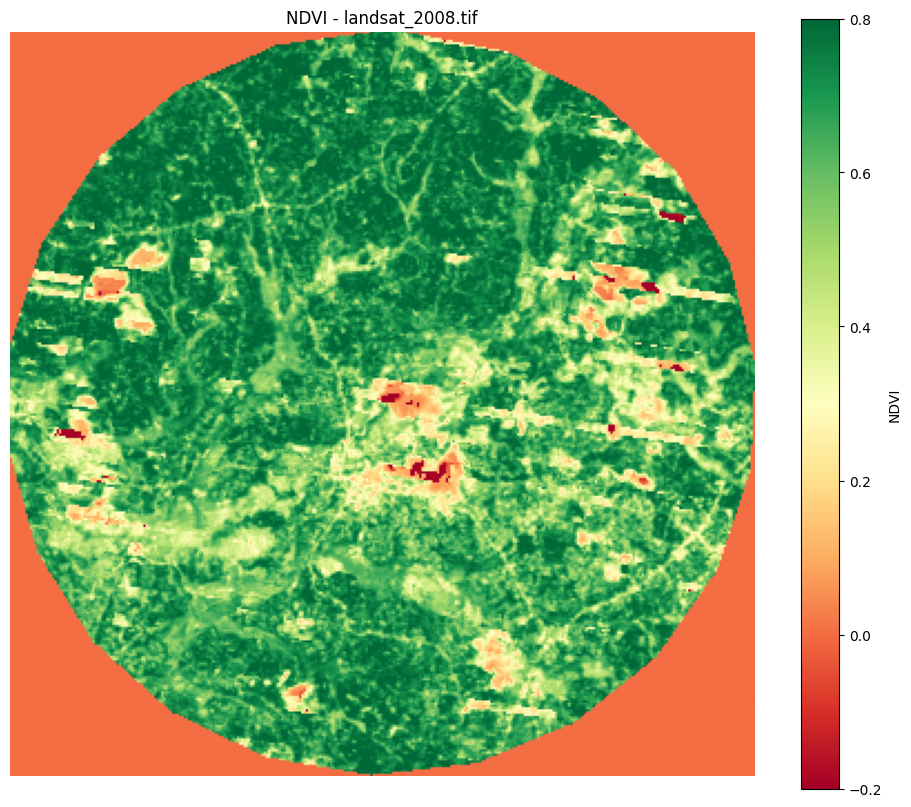

NDVI visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2008_ndvi.png
Visualizing landsat_2005.tif...


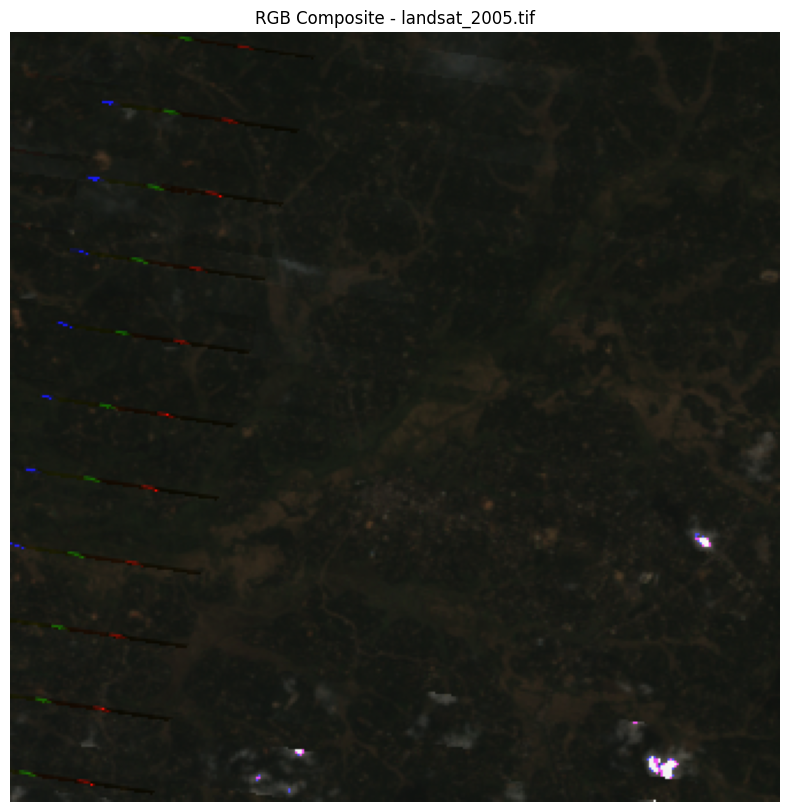

Visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2005_rgb.png


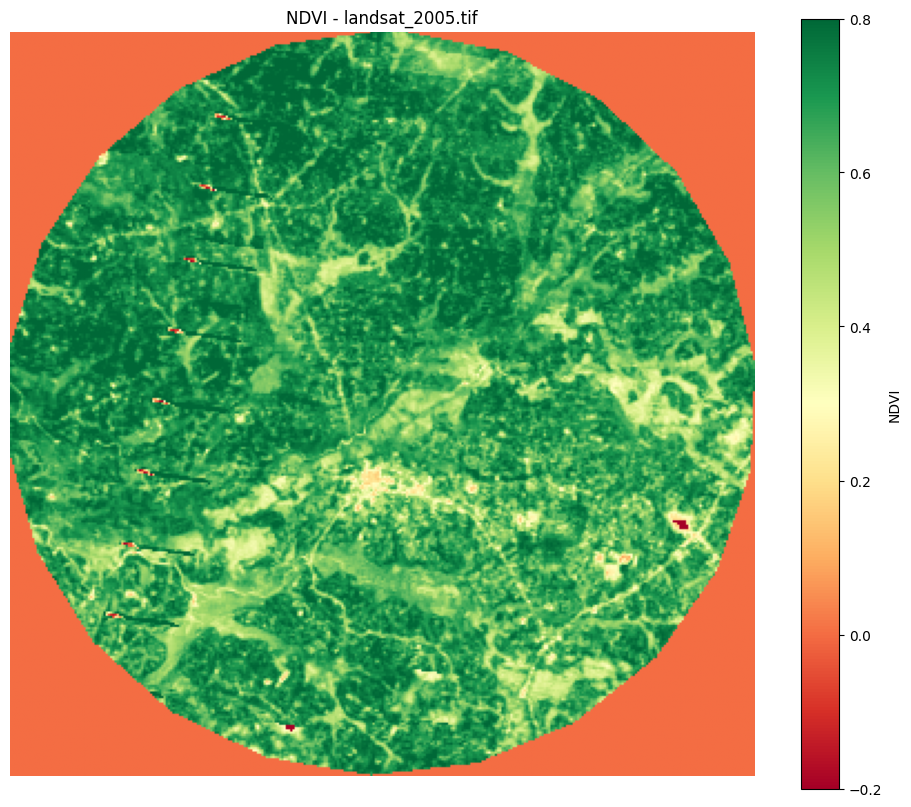

NDVI visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2005_ndvi.png
Visualizing landsat_2009.tif...


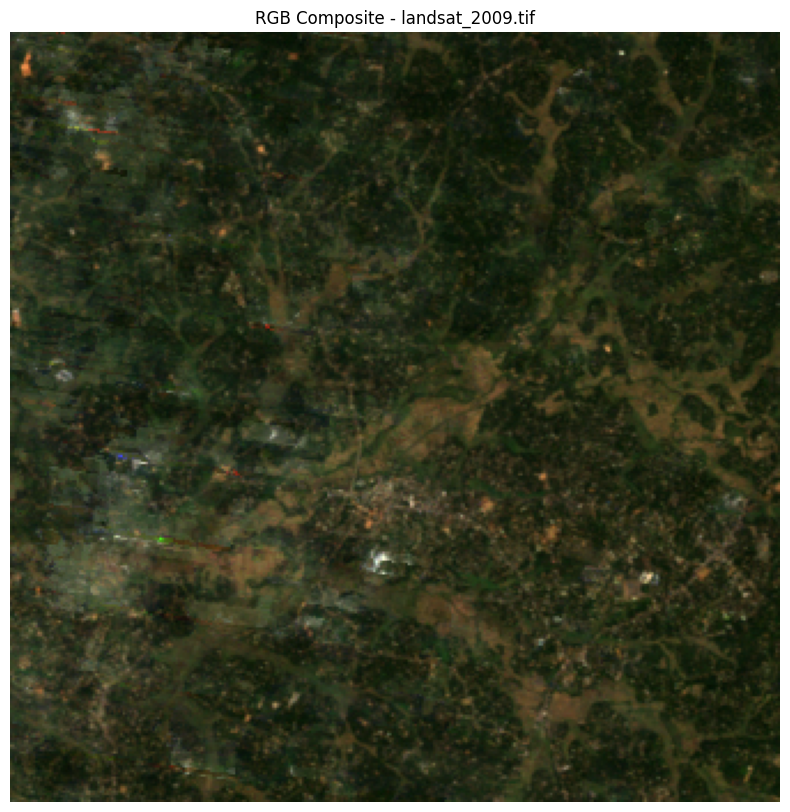

Visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2009_rgb.png


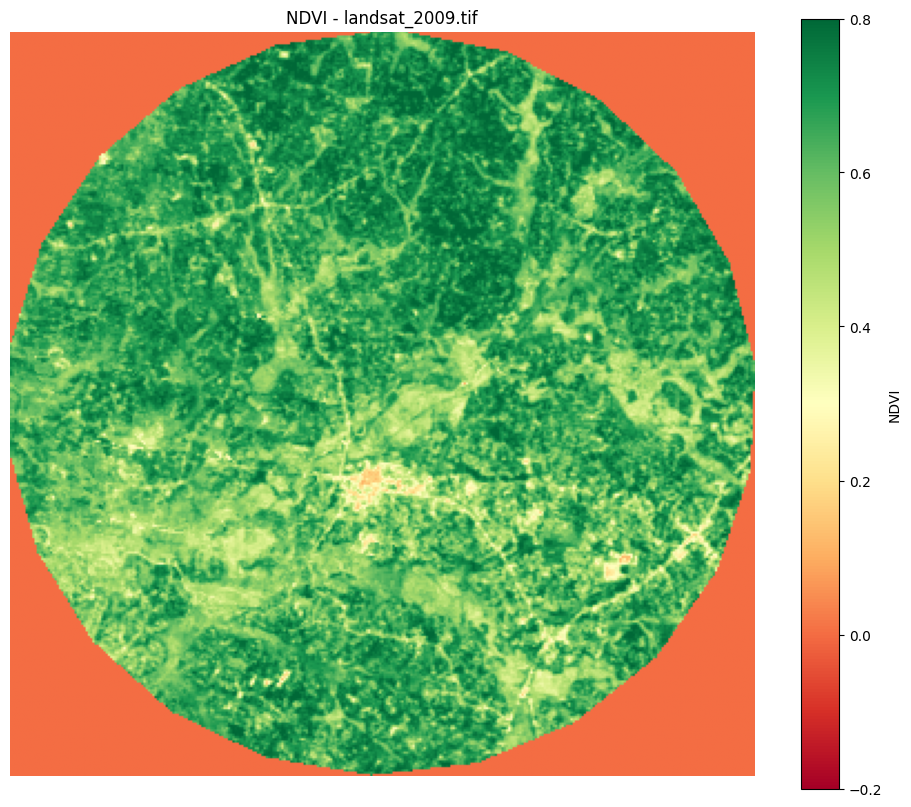

NDVI visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2009_ndvi.png
Visualizing landsat_2011.tif...


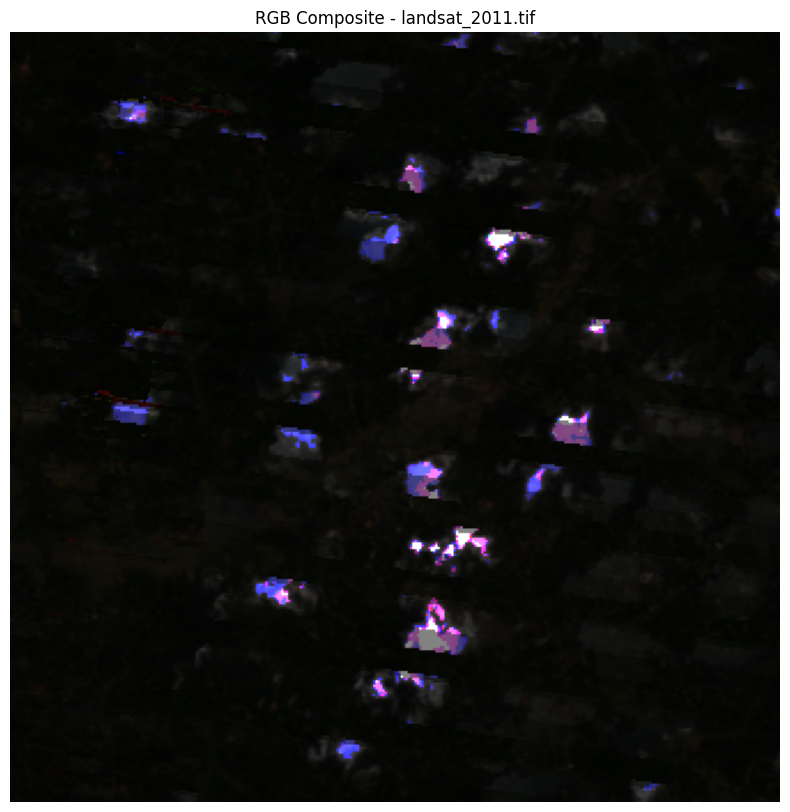

Visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2011_rgb.png


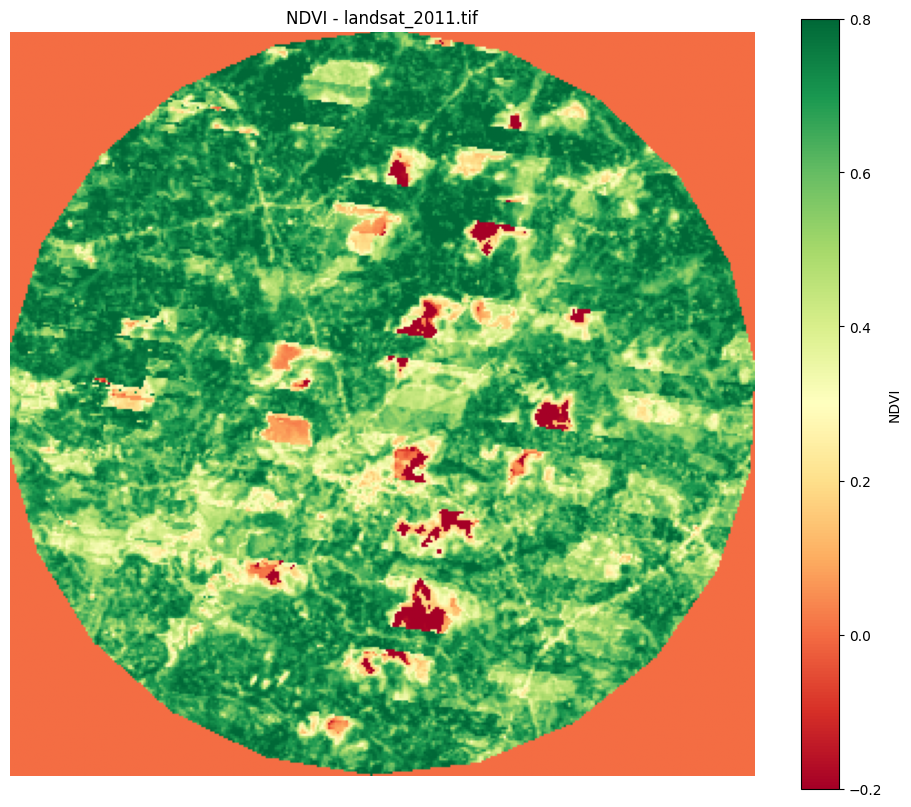

NDVI visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2011_ndvi.png
Visualizing landsat_2012.tif...


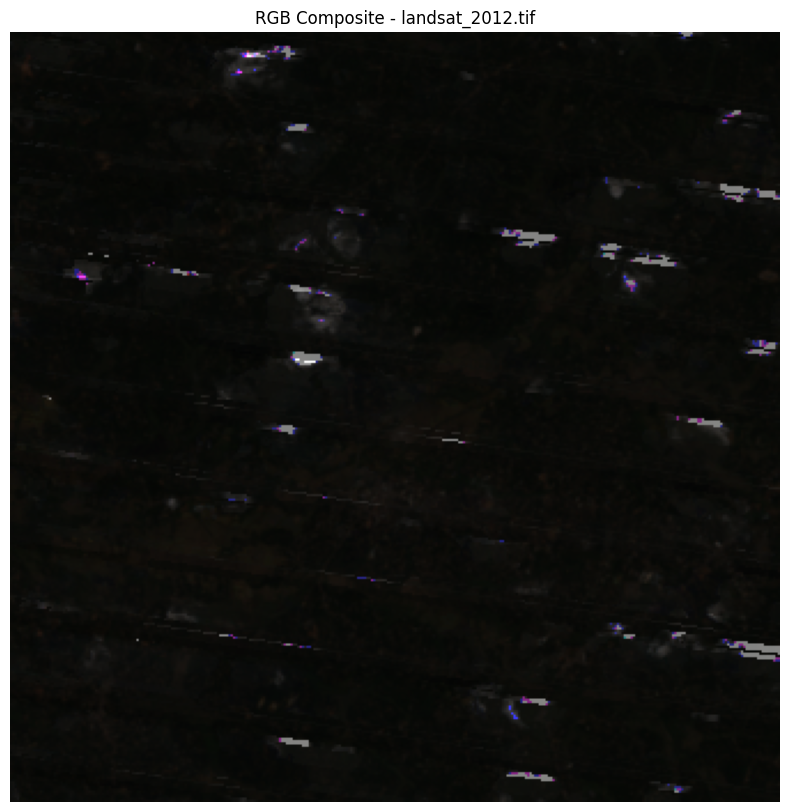

Visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2012_rgb.png


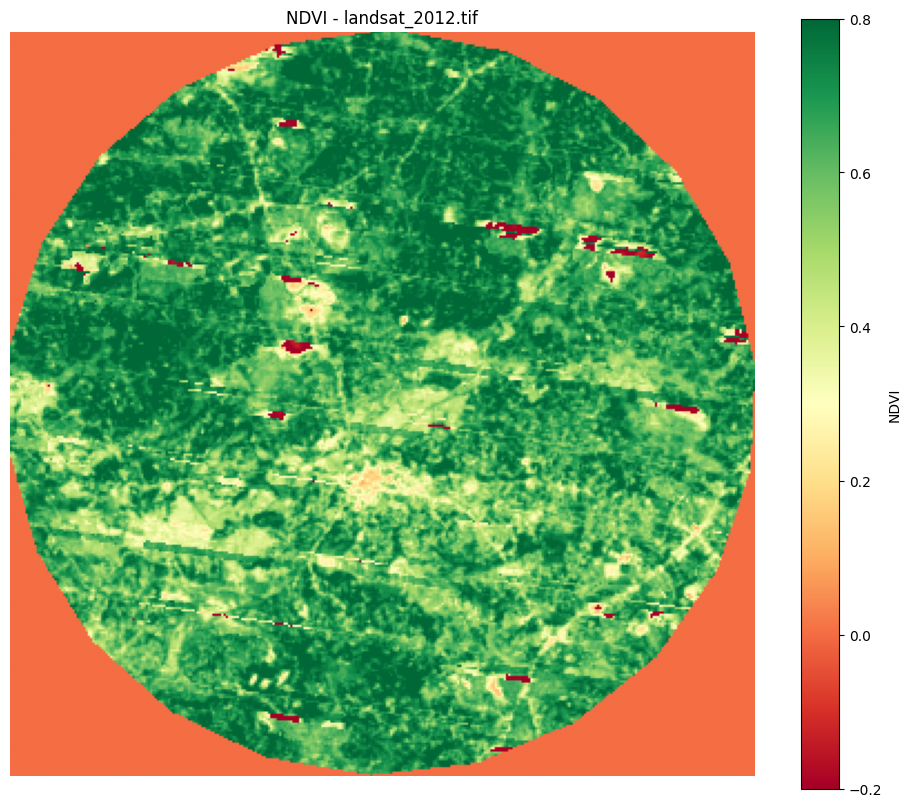

NDVI visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2012_ndvi.png
Visualizing landsat_2010.tif...


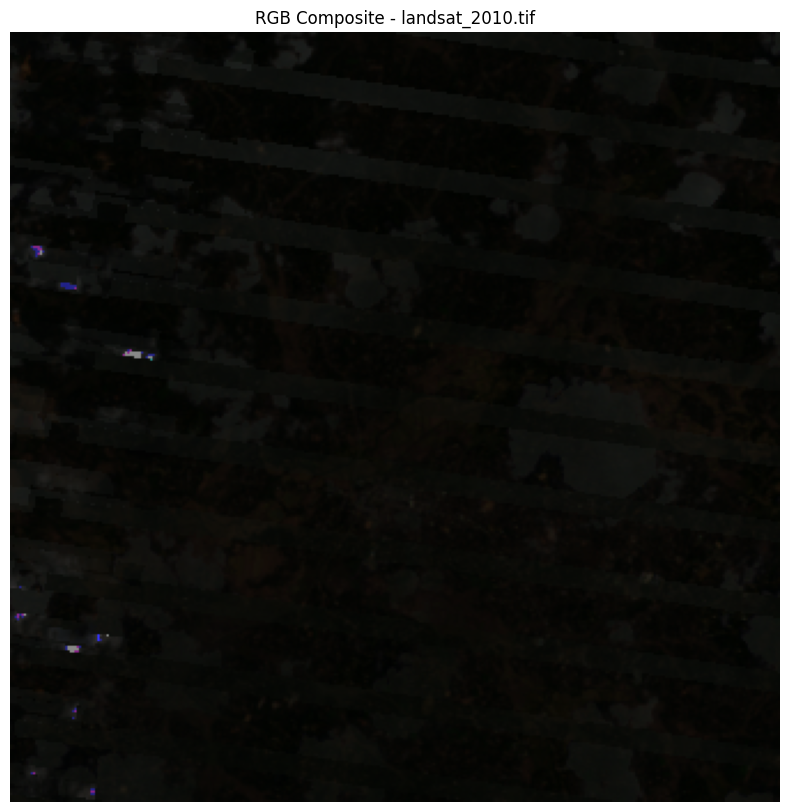

Visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2010_rgb.png


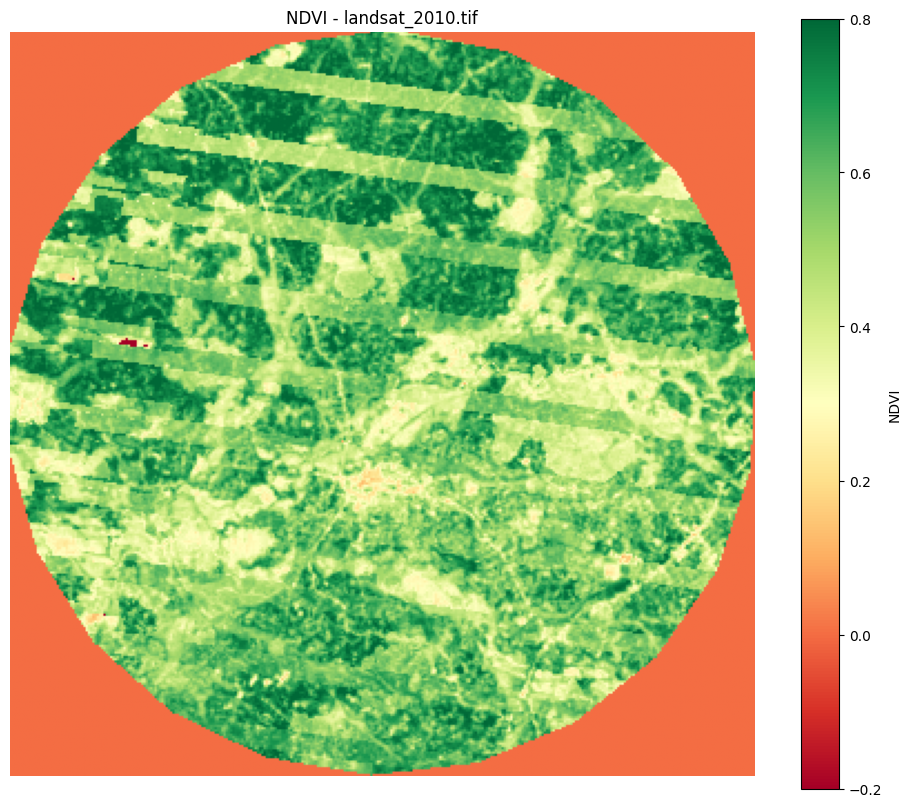

NDVI visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2010_ndvi.png
Visualizing landsat_2013.tif...


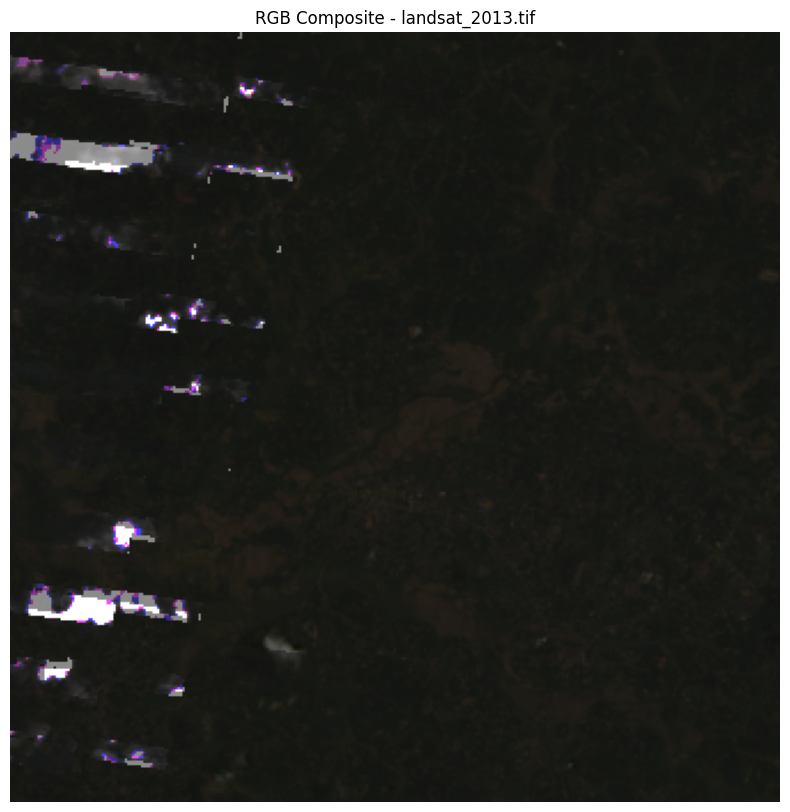

Visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2013_rgb.png


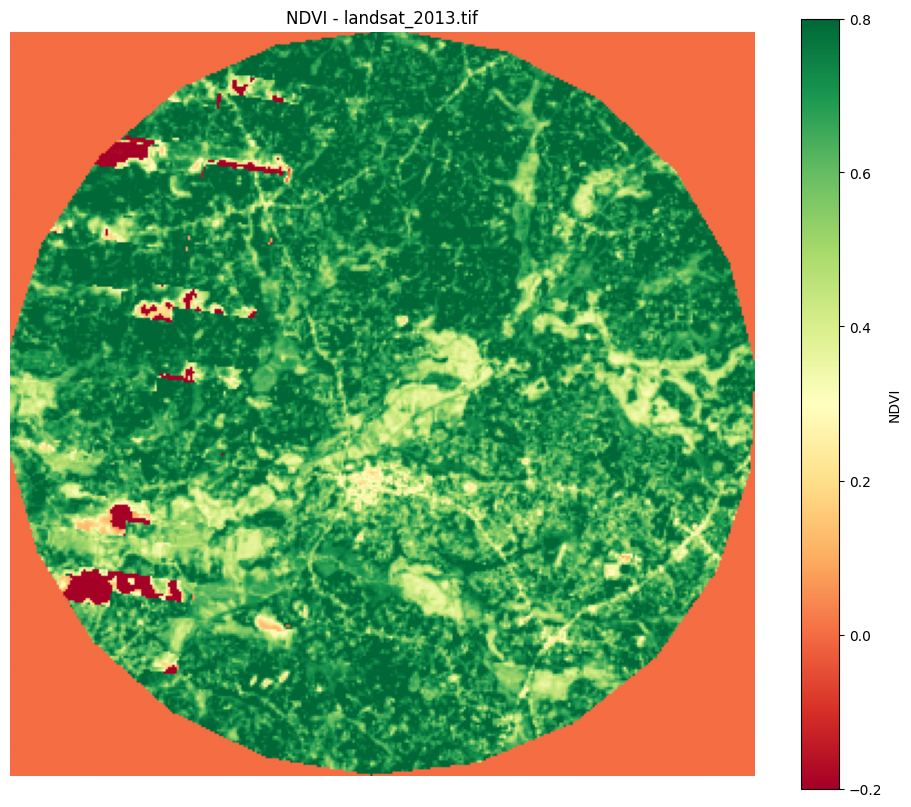

NDVI visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2013_ndvi.png
Visualizing landsat_2014.tif...


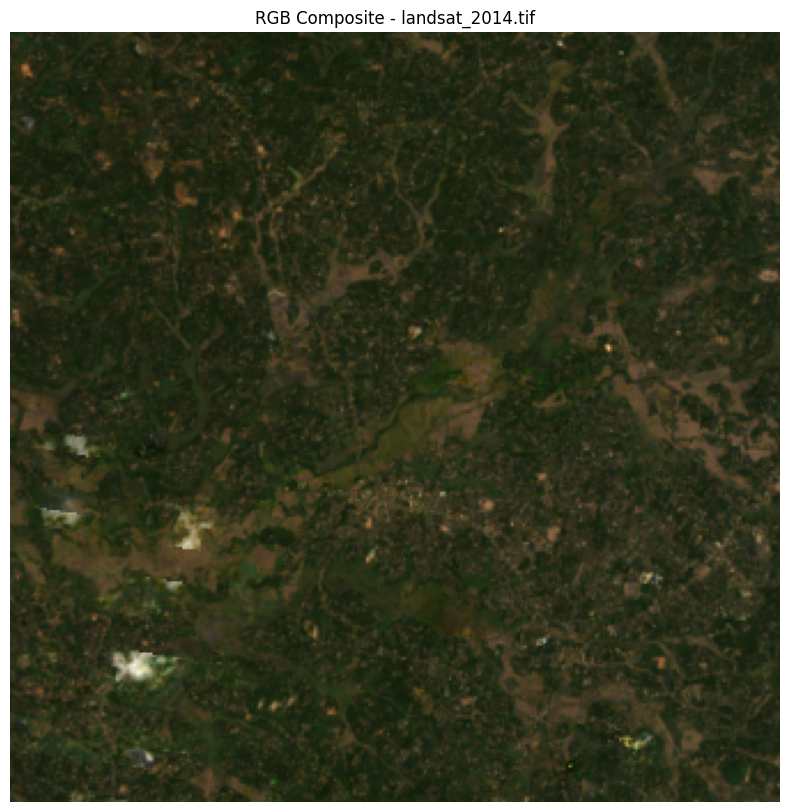

Visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2014_rgb.png


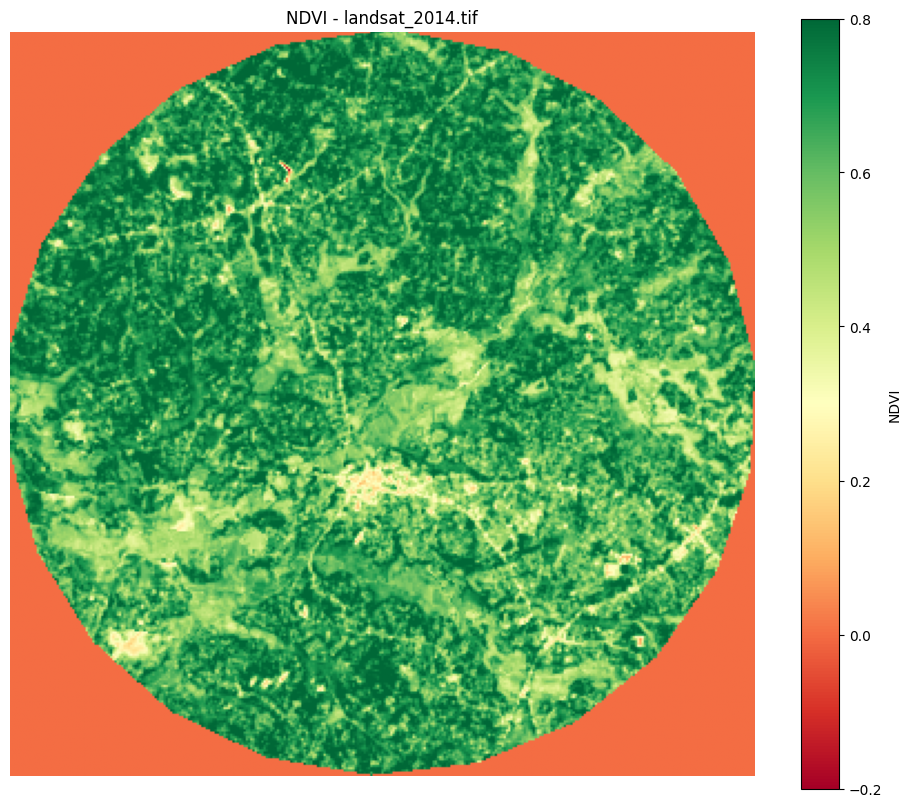

NDVI visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2014_ndvi.png
Visualizing landsat_2016.tif...


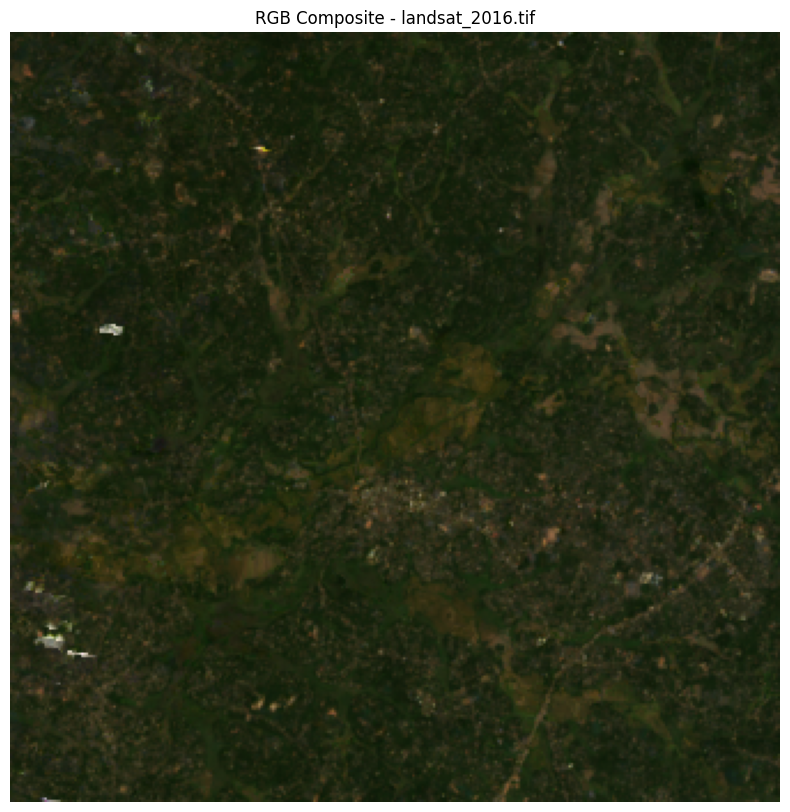

Visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2016_rgb.png


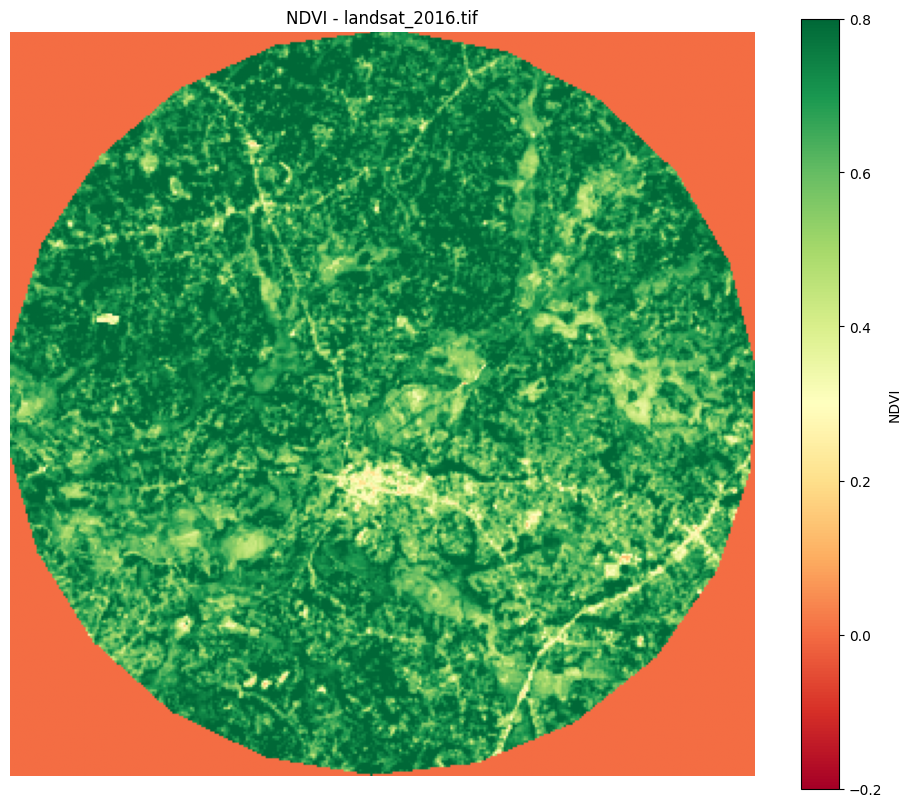

NDVI visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2016_ndvi.png
Visualizing landsat_2017.tif...


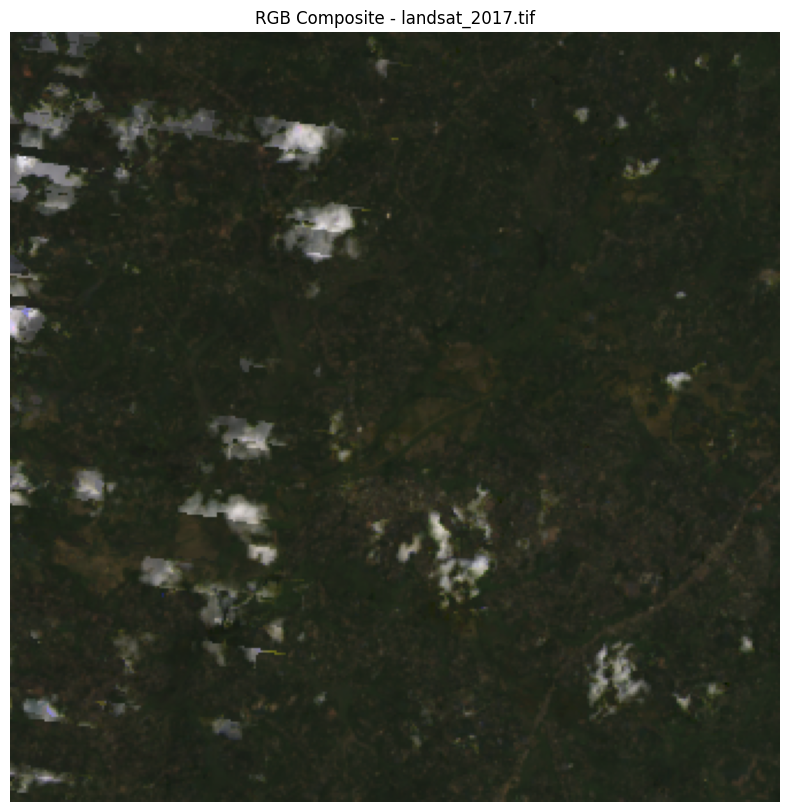

Visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2017_rgb.png


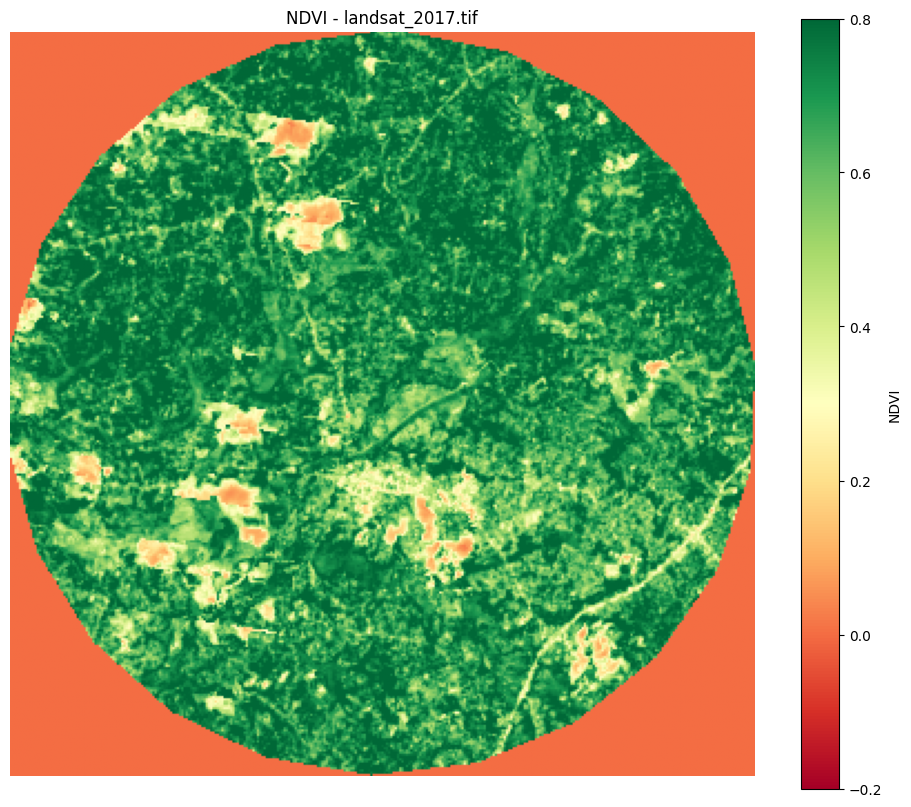

NDVI visualization saved: /content/drive/MyDrive/coconut_plantation_research/data/raw/Minuwangoda/landsat/landsat_2017_ndvi.png
Visualizing landsat_2018.tif...


In [ ]:
# Select a study area to explore
area_name = 'Minuwangoda'

# Define paths to downloaded images
landsat_dir = os.path.join(base_dir, "data/raw", area_name, "landsat")
sentinel_dir = os.path.join(base_dir, "data/raw", area_name, "sentinel")

# List downloaded images
landsat_files = [os.path.join(landsat_dir, f) for f in os.listdir(landsat_dir) if f.endswith('.tif')]
sentinel_files = [os.path.join(sentinel_dir, f) for f in os.listdir(sentinel_dir) if f.endswith('.tif')]

print(f"Found {len(landsat_files)} Landsat files") #print(f"Found {len(landsat_files)} Landsat files and {len(sentinel_files)} Sentinel-2 files")

# Visualize Landsat images
for file in landsat_files:
    print(f"Visualizing {os.path.basename(file)}...")
    visualize_geotiff(file)
    visualize_ndvi_geotiff(file)

# Visualize Sentinel-2 images
for file in sentinel_files:
    print(f"Visualizing {os.path.basename(file)}...")
    visualize_geotiff(file)
    visualize_ndvi_geotiff(file)


Analyze NDVI changes over time:

Year 2005: Mean NDVI = 0.4929
Year 2010: Mean NDVI = 0.4253


Year 2015: Mean NDVI = 0.5763
Year 2020: Mean NDVI = 0.4839


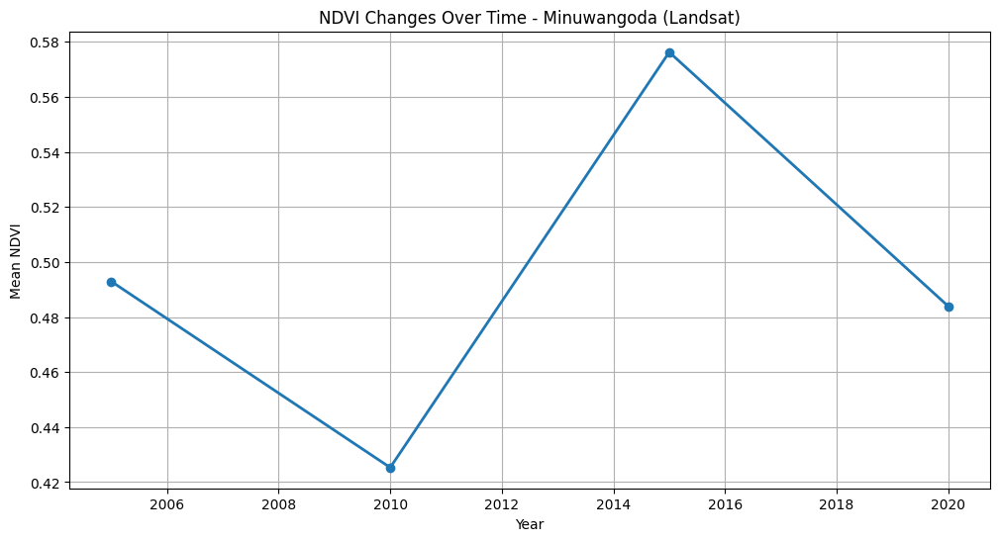

In [ ]:
# Extract year from filename
def extract_year(filename):
    import re
    match = re.search(r'_(\d{4})\.tif', filename)
    if match:
        return int(match.group(1))
    return None

# Extract NDVI statistics from images
def extract_ndvi_stats(image_path, ndvi_band=-1):
    with rasterio.open(image_path) as src:
        data = src.read()
        if ndvi_band < 0:
            ndvi_band = data.shape[0] + ndvi_band

        if ndvi_band < data.shape[0]:
            ndvi = data[ndvi_band]
            return {
                'mean': np.mean(ndvi),
                'median': np.median(ndvi),
                'min': np.min(ndvi),
                'max': np.max(ndvi),
                'std': np.std(ndvi)
            }
    return None

# Analyze NDVI changes for Landsat
landsat_years = []
landsat_ndvi_means = []

for file in sorted(landsat_files, key=extract_year):
    year = extract_year(file)
    if year:
        stats = extract_ndvi_stats(file)
        if stats:
            landsat_years.append(year)
            landsat_ndvi_means.append(stats['mean'])
            print(f"Year {year}: Mean NDVI = {stats['mean']:.4f}")

# Plot NDVI changes over time
plt.figure(figsize=(12, 6))
plt.plot(landsat_years, landsat_ndvi_means, 'o-', linewidth=2)
plt.xlabel('Year')
plt.ylabel('Mean NDVI')
plt.title(f'NDVI Changes Over Time - {area_name} (Landsat)')
plt.grid(True)
plt.savefig(os.path.join(base_dir, "results/figures", f"{area_name}_ndvi_changes.png"), dpi=300)
plt.show()

